In [1]:
from astropy.table import Table
from dendrocat import RadioSource
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from scipy import interpolate
import pandas as pd
import sympy as syp
from astropy import units as u
import radio_beam
from astropy.table import Table
from radio_beam import Beam
from astropy import coordinates
from astropy import wcs
from astropy.nddata.utils import Cutout2D
from astropy.io import ascii
from matplotlib.patches import Rectangle, Ellipse

W51 = '/orange/adamginsburg/w51/TaehwaYoo/'
W51b6 = '/orange/adamginsburg/w51/TaehwaYoo/2015.1.01596.S_W51_B6_LB/continuum_images/'
W51cont='/orange/adamginsburg/w51/TaehwaYoo/b6contfits/'
w51e2_b6_briggs=W51cont+'W51e2_cont_bigbriggs.image.fits'
w51e2_b6_robust0=W51cont+'W51e2_cont_big_robust0.image.fits'
w51e2_b6_uniform=W51cont+'W51e2_cont_biguniform.image.fits'
w51e2_b6_superuniform=W51cont+'W51e2_cont_bigsuperuniform.image.fits'

w51n_b6_briggs = W51cont+'W51n_cont_bigbriggs.image.fits'
w51n_b6_robust0 = W51cont+'w51n_cont_big_robust0.image.fits'
w51n_b6_uniform = W51cont+'W51n_cont_biguniform.image.fits'
w51n_b6_superuniform = W51cont+'W51n_cont_bigsuperuniform.image.fits'
w51n_b6_natural = W51cont+'W51n_cont_bignatural.image.fits'

W51b3 = '/orange/adamginsburg/w51/TaehwaYoo/2017.1.00293.S_W51_B3_LB/may2021_successful_imaging/'

w51n_b3_tt0 = W51b3+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'
w51n_b3_tt1 = W51+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt1.pbcor.fits'
w51n_b3_alpha = W51+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.alpha.pbcor.fits'

w51conv = '/orange/adamginsburg/w51/TaehwaYoo/convolved_new/'
w51n_b6_conv = w51conv + 'w51n_cont_bigbriggs.image.convB3_briggs.fits'

w51e_b3_tt0 = W51b3+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'
w51e2_b3_tt1 = W51+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt1.pbcor.fits'
w51e2_b3_alpha = W51+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.alpha.pbcor.fits'

w51e2_b6_conv = w51conv + 'w51e2_cont_bigbriggs.image.convB3_briggs.fits'

w51e_b6_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51e_B6_conv.fits'
w51e_b3_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51e_B3_conv.fits'


w51n_b3_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51n_B3_conv.fits'

w51n_b3_almaimf = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/W51-IRS2_B3_uid___A001_X1296_X18f_continuum_merged_12M_robust0_selfcal4_finaliter.image.tt0.pbcor.fits'
w51n_b6_almaimf = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/W51-IRS2_B6_uid___A001_X1296_X187_continuum_merged_12M_robust0_selfcal9_finaliter.image.tt0.pbcor.fits'
w51e_b3_almaimf = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/W51-E_B3_uid___A001_X1296_X10b_continuum_merged_12M_robust0_selfcal7_finaliter.image.tt0.pbcor.fits'
w51e_b6_almaimf = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/W51-E_B6_uid___A001_X1296_X213_continuum_merged_12M_robust0_selfcal7_finaliter.image.tt0.pbcor.fits'


w51n_b6_conv_briggs = w51conv + 'w51n_briggs_B6_conv.fits'
w51n_b6_conv_robust0 = w51conv + 'w51n_robust0_B6_conv.fits'
w51n_b6_conv_superuniform = w51conv + 'w51n_superuniform_B6_conv.fits'

w51e_b6_conv_briggs = w51conv + 'w51e_briggs_B6_conv.fits'
w51e_b6_conv_robust0 = w51conv + 'w51e_robust0_B6_conv.fits'
w51n_b6_conv_superuniform = w51conv + 'w51e_superuniform_B6_conv.fits'
#----------

#w51e_b3_tt0 = '/Users/dbahck37/W51data/w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'

#w51e_b6_conv_briggs ='/Users/dbahck37/W51data/convolved_new/w51e_briggs_B6_conv.fits'

catalogdir = '/orange/adamginsburg/ALMA_IMF/catalogs/getsf-smoothed/'
cat_w51e = catalogdir + 'W51-E-getsf.cat'
cat_w51n = catalogdir + 'W51-IRS2-getsf.cat'

w51e_dendro_matched_catalog = '/home/t.yoo/w51/catalogue/dendrogram/dendro_w51e_matched.fits'
w51n_dendro_matched_catalog = '/home/t.yoo/w51/catalogue/dendrogram/dendro_w51n_matched.fits'

w51e_b6_calibrated2 = '/orange/adamginsburg/w51/alma/TaehwaYoo/w51_b6_e2_selfcal_tyoo_cont_20230822/w51e2.spw0thru19.14500.robust0.thr0.1mJy.mfs.I.startmod.selfcal6.image.tt0.fits'
w51e_b6_calibrated = '/orange/adamginsburg/w51/TaehwaYoo/w51e2.spw0thru19.14500.robust0.thr0.15mJy.mfs.I.startmod.selfcal7.image.tt0.fits'
w51n_b6_calibrated = '/orange/adamginsburg/w51/TaehwaYoo/w51n.spw0thru19.14500.robust0.thr0.1mJy.mfs.I.startmod.selfcal7.image.tt0.fits'



w51e_b6_calibrated_pbcor = '/orange/adamginsburg/w51/TaehwaYoo/w51e2.spw0thru19.14500.robust0.thr0.15mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'
w51n_b6_calibrated_pbcor = '/orange/adamginsburg/w51/TaehwaYoo/w51n.spw0thru19.14500.robust0.thr0.1mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'



rec_ind [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  16  17  18
  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37
  39  40  41  42  43  45  46  47  48  49  50  51  52  53  54  55  56  57
  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75
  76  77  78  79  80  83  84  85  86  87  88  89  90  91  93  94  96  97
  98  99 100 101 103 104 105 106 107 112 113 116 118]
num 127 103
rec_ind [ 0  1  2  3  4  5  7  8  9 10 11 12 13 14 16 17 18 20 28 29 31 35 55 57
 82]
num 127 25
x_pix
-----
 8253
 8101
 7028
 7628
 7826
 7764
 7491
 7343
 7604
 7146
 7185
 7552
 7083
 7782
 7183
 7047
 7280
 7047
 7008
 7272
 7256
 7115 y_pix
-----
 7015
 7129
 7167
 7226
 7273
 7278
 7286
 7299
 7294
 7319
 7303
 7307
 7351
 7331
 7333
 7342
 7351
 7358
 7361
 7367
 7409
 7311
ind1 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20]


(6800.0, 7889.330901754125)

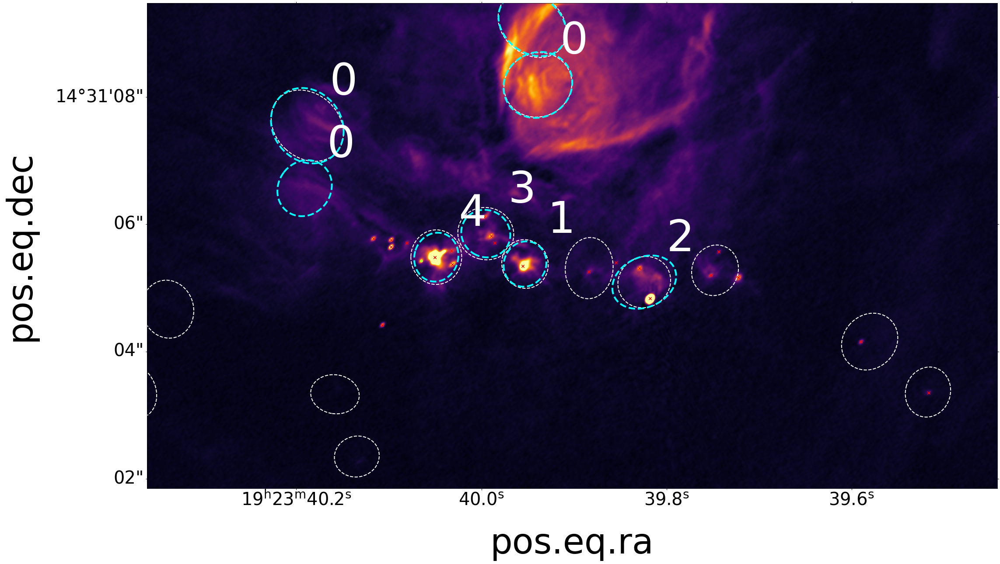

In [2]:
plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
from matplotlib import colors

fitsdata = fits.open(w51n_b3_tt0)
image = fitsdata[0].data
hdrNB = fits.getheader(w51n_b3_tt0)  
wcsNB = WCS(hdrNB,naxis=2)
scaleNB = wcsNB.proj_plane_pixel_scales()[0]
scaleNB_phy = scaleNB * np.pi / 180 * 5.41e3 

def count_points_in_ellipse(xcen,ycen,major,minor,pa,xpos,ypos):
    # caclulate foci positions 
    # must be full major, minor not semi major, minor
    fodx = np.cos(pa)*np.sqrt((major/2)**2-(minor/2)**2)
    fody = np.sin(pa)*np.sqrt((major/2)**2-(minor/2)**2)
    
    fox1 = xcen + fodx
    foy1 = ycen + fody
    
    fox2 = xcen - fodx
    foy2 = ycen - fody
    
    dist1 = np.sqrt((xpos-fox1)**2+(ypos-foy1)**2)
    dist2 = np.sqrt((xpos-fox2)**2+(ypos-foy2)**2)
    
    isinside = np.where(dist1+dist2<major)[0]
    
    return len(isinside), isinside

def plot_catalog_on_image(ax,image,hdrNB,catdatadir,isb3=True,beam=None,use_criteria=True, 
                          label=None,color='cyan',lw=2,aperture='fwhm+beam',xysource=None,
                          vmin=-0.000103489713773963128,vmax=0.0022162524723021867,ls='dashed',
                         ispower=False,fontsize=100):
    catdata = ascii.read(catdatadir,data_start=0,format='commented_header', header_start=120,  comment="!")
    sky_ra = catdata['WCS_ACOOR']
    sky_dec = catdata['WCS_DCOOR']
    no = catdata['NO']
    if isb3:
        bandlabel = '03'
    else:
        bandlabel = '02'
    fooa = catdata['FOOA%s'%bandlabel]
    foob = catdata['FOOB%s'%bandlabel]
    theta = catdata['THETA%s'%bandlabel]
    afwhm = catdata['AFWHM%s'%bandlabel]
    bfwhm = catdata['BFWHM%s'%bandlabel]
   
    if use_criteria and label is None:
        
        rec_ind = np.where((np.abs(catdata['GOODM%s'%bandlabel])>1)&
                   (np.abs(catdata['SIGNM%s'%bandlabel])>1)&
                   (catdata['FXP_BST%s'%bandlabel]/catdata['FXP_ERR%s'%bandlabel]>=2)&
                   (catdata['FXT_BST%s'%bandlabel]/catdata['FXT_ERR%s'%bandlabel]>=2)&
                   (catdata['AFWHM%s'%bandlabel]/catdata['BFWHM%s'%bandlabel]<=2)&
                   (catdata['FOOA%s'%bandlabel]/catdata['AFWHM%s'%bandlabel]>1.15))[0]
        """
        rec_ind = np.where((np.abs(catdata['GOODM03'])>1)&
                   (np.abs(catdata['SIGNM03'])>1)&
                   (catdata['FXP_BST03']/catdata['FXP_ERR03']>2)&
                   (catdata['FXT_BST03']/catdata['FXT_ERR03']>2)&
                   (catdata['AFWHM03']/catdata['BFWHM03']<2)&
                   (catdata['FOOA03']/catdata['AFWHM03']>1.15) &
                   (np.abs(catdata['GOODM02'])>1) &
                   (np.abs(catdata['SIGNM02'])>1)&
                   (catdata['FXP_BST02']/catdata['FXP_ERR02']>2)&
                   (catdata['FXT_BST02']/catdata['FXT_ERR02']>2)&
                   (catdata['AFWHM02']/catdata['BFWHM02']<2)&
                   (catdata['FOOA02']/catdata['AFWHM02']>1.15))[0]
        """
        print('rec_ind',rec_ind)
        print('num',len(sky_ra),len(rec_ind))
        sky_ra= sky_ra[rec_ind]
        sky_dec = sky_dec[rec_ind]
        fooa = fooa[rec_ind]
        foob = foob[rec_ind]
        theta = theta[rec_ind]
        no = no[rec_ind]
        afwhm = afwhm[rec_ind]
        bfwhm = bfwhm[rec_ind]
        
    
    if label is not None:
        label = [i-1 for i in label]
        sky_ra= sky_ra[label]
        sky_dec = sky_dec[label]
        fooa = fooa[label]
        foob = foob[label]
        theta = theta[label]
        no = no[label]
        afwhm = afwhm[label]
        bfwhm = bfwhm[label]

    skypos = np.vstack((sky_ra,sky_dec)).T

    
    wcsNB = WCS(hdrNB,naxis=2)
    scaleNB = wcsNB.proj_plane_pixel_scales()[0]
    beamNB = Beam.from_fits_header(hdrNB)


    image = fitsdata[0].data[0][0]
    if ispower:
        ax1.imshow(image, origin='lower',cmap=plt.get_cmap('inferno'),norm=colors.PowerNorm(gamma=0.5,vmin=vmin,vmax=vmax))
    else:
        ax1.imshow(image, origin='lower',cmap=plt.get_cmap('inferno'),vmin=vmin,vmax=vmax)

    xypos = wcsNB.wcs_world2pix(skypos,0)
    xpos = xypos[:,0]
    ypos = xypos[:,1]
    
    
        
    indexlist = []
    for i in range(len(xypos)):
        if aperture is 'footprint':
            major = fooa[i]/3600/scaleNB.value
            minor = foob[i]/3600/scaleNB.value
            pa = theta[i]+90
        elif aperture is 'fwhm+beam':
            meanbeamsize = (beam.major.value+beam.minor.value)/4
            major = (afwhm[i]/3600+meanbeamsize)/scaleNB.value
            minor = (bfwhm[i]/3600+meanbeamsize)/scaleNB.value
            pa = 90+theta[i]
        elif aperture is 'beam':
            major = beam.major.value/scaleNB.value
            minor = beam.minor.value/scaleNB.value
            pa = 90+beam.pa.value

        ellipse = Ellipse(xypos[i],width=major,height=minor,facecolor='none',
                          angle=90+pa,edgecolor=color,lw=lw,ls=ls)
        
        ax.add_patch(ellipse)
        if xysource is not None:
            numsource, indsource = count_points_in_ellipse(xpos[i],ypos[i],major,minor,90+pa,xysource[:,0],xysource[:,1])
            

            ax.text(xpos[i]+50,ypos[i]+70,'%d'%numsource,color='w',fontsize=fontsize,clip_on=True)
            indexlist.append(indsource)
    if xysource is not None:
        return indexlist
    
def plot_dendrogram(ax, catalog , wcsNB=None,legend=True, size=40,color='r' ):
    if wcsNB is not None:
        xsky = catalog['x_sky']
        ysky = catalog['y_sky']
        xysky = np.vstack((xsky, ysky)).T
        xypos = wcsNB.wcs_world2pix(xysky,0)
        xpos = xypos[:,0]
        ypos = xypos[:,1]
        
    else:
        xpos = catalog['x_pix']
        ypos = catalog['y_pix']
    print(xpos,ypos)
    kind = catalog['kind']
    
    #detected in both band
    ind1 = np.where(kind==0)[0]
    print('ind1',ind1)
    ax.scatter(xpos[ind1], ypos[ind1], s=size, marker='x',color=color,label='B3B6')
    #detected in only one band
    ind2 = np.where(kind==1)[0]
    ax.scatter(xpos[ind2], ypos[ind2], s=size-10, marker='o',color='greenyellow',label='B3')
    ind3 = np.where(kind==2)[0]
    ax.scatter(xpos[ind3], ypos[ind3], s=size-10, marker='s',color='cyan',label='B6')
    
def plot_dendrogram_new(ax, catalog , wcsNB=None,legend=True, size=80,color='cyan',band='b6' ):
    if wcsNB is not None:
        xsky = catalog['%s_xsky'%band]
        ysky = catalog['%s_ysky'%band]
        xysky = np.vstack((xsky, ysky)).T
        xypos = wcsNB.wcs_world2pix(xysky,0)
        xpos = xypos[:,0]
        ypos = xypos[:,1]
        
    else:
        xpos = catalog['%s_xpix'%band]
        ypos = catalog['%s_ypix'%band]
    
    ax.scatter(xpos, ypos, s=size, marker='o',edgecolor=color,facecolor='none')
   
    
    
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)
catalog = Table.read('../spectral_index/w51n_combined_catalog.fits',format='fits')
hdrNBalmaimf = fits.getheader(w51n_b3_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
xysource = np.vstack((catalog['x_pix'],catalog['y_pix'])).T
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=True,beam=beamalmaimf,use_criteria=False,color='w')
plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,color='w')
plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=True,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4)
plot_dendrogram(ax1, catalog)
ax1.set_xlim(6500, 6500+0.35/scaleNB_phy.value)
ax1.set_ylim(6800, 6800+0.2/scaleNB_phy.value)


plot for the new image

rec_ind [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 27 28 29 30 32]
num 41 29


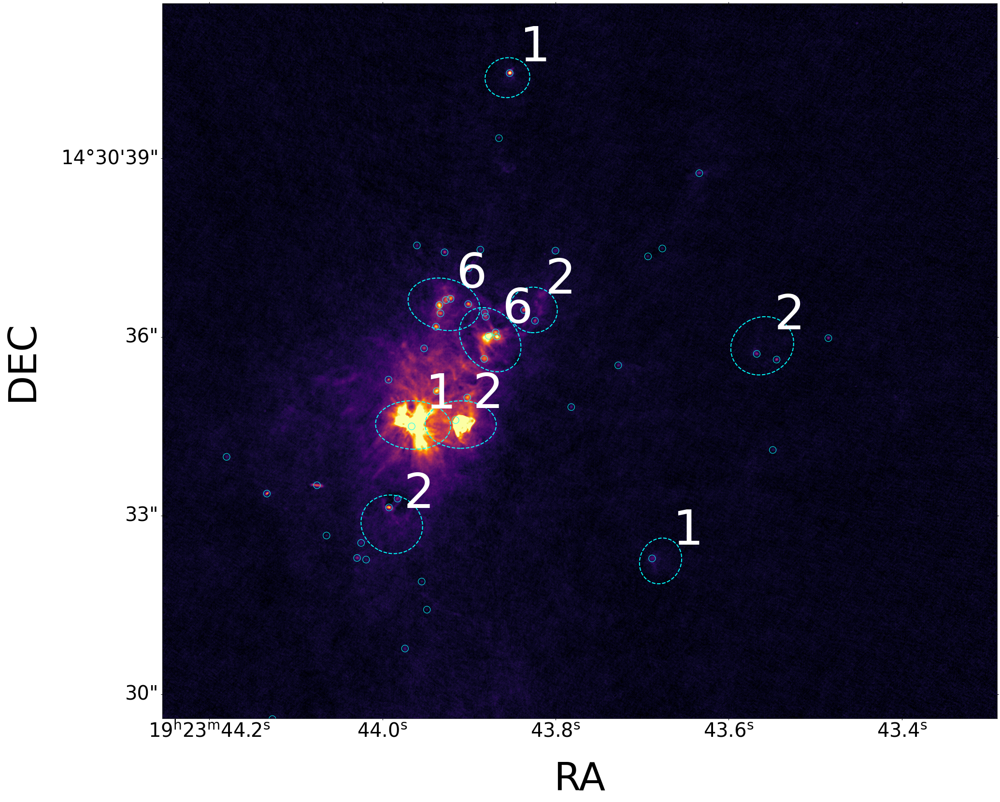

In [3]:

from astropy.coordinates import SkyCoord
fitsdata = fits.open(w51e_b6_calibrated_pbcor)
image = fitsdata[0].data
hdrNB = fits.getheader(w51e_b6_calibrated_pbcor)  
wcsNB = WCS(hdrNB,naxis=2)
scaleNB = wcsNB.proj_plane_pixel_scales()[0]
scaleNB_phy = scaleNB * np.pi / 180 * 5.41e3 
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')

hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['b6_xsky'],catalog['b6_ysky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=False,color='w',xysource=xysource)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan',xysource=xysource)

#plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4,label=[1,6,2,41,5,7,68,25])
plot_dendrogram_new(ax1, catalog, wcsNB = wcsNB,size=200)

lim1 = wcsNB.world_to_pixel(SkyCoord(290.93426384, 14.50523611, unit='deg'))
lim2 = wcsNB.world_to_pixel(SkyCoord(290.93084938, 14.51165277, unit='deg'))
ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
ax1.set_xlim(6000,9500)
ax1.set_ylim(6000,9000)
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
plt.savefig('w51e_almaimf_highres_new2.png')


rec_ind [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 27 28 29 30 32]
num 41 29


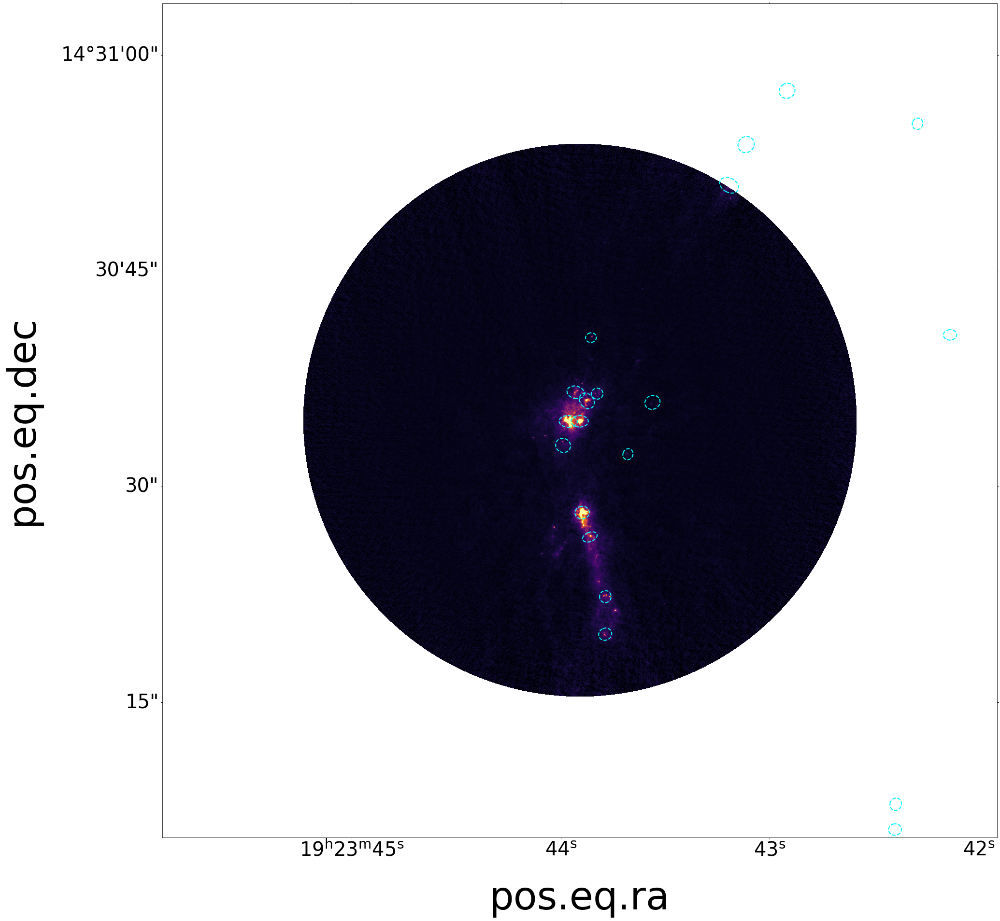

In [4]:
from astropy.coordinates import SkyCoord
fitsdata = fits.open(w51e_b6_calibrated_pbcor)
image = fitsdata[0].data
hdrNB = fits.getheader(w51e_b6_calibrated_pbcor)  
wcsNB = WCS(hdrNB,naxis=2)
scaleNB = wcsNB.proj_plane_pixel_scales()[0]
scaleNB_phy = scaleNB * np.pi / 180 * 5.41e3 
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')

hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['b6_xsky'],catalog['b6_ysky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=False,color='w',xysource=xysource)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan')

rec_ind [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 27 28 29 30 32]
num 41 29
<SkyCoord (ICRS): (ra, dec) in deg
    (290.93439297, 14.50822222)> <SkyCoord (ICRS): (ra, dec) in deg
    (290.93037595, 14.51155554)>


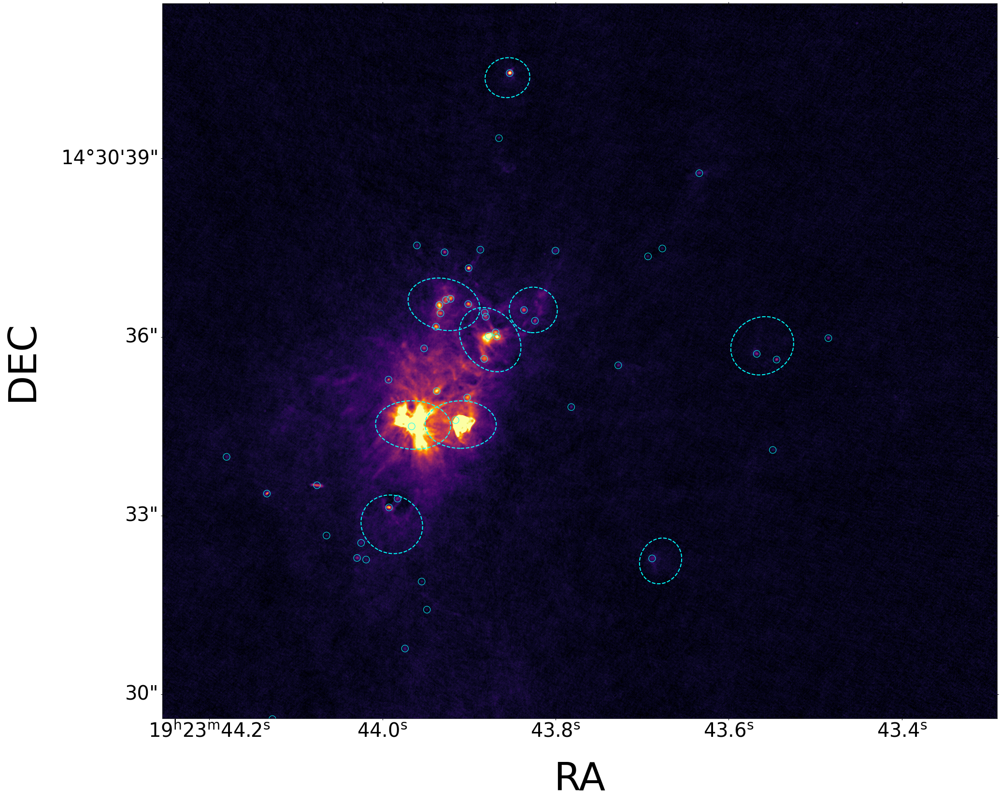

In [5]:
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')

hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['b6_xsky'],catalog['b6_ysky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=False,color='w',xysource=xysource)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan')

#plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4,label=[1,6,2,41,5,7,68,25])
plot_dendrogram_new(ax1, catalog, wcsNB = wcsNB,size=200)

lim1 = wcsNB.world_to_pixel(SkyCoord(290.93426384, 14.50523611, unit='deg'))
lim2 = wcsNB.world_to_pixel(SkyCoord(290.93084938, 14.51165277, unit='deg'))
ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
ax1.set_xlim(6000,9500)
ax1.set_ylim(6000,9000)
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
plt.savefig('w51e_almaimf_highres_new1.png')
skylim1 = wcsNB.pixel_to_world(6000,6000)
skylim2 = wcsNB.pixel_to_world(9500,9000)

print(skylim1,skylim2)

[[290.93439297  14.50822222]
 [290.93037595  14.51155554]]


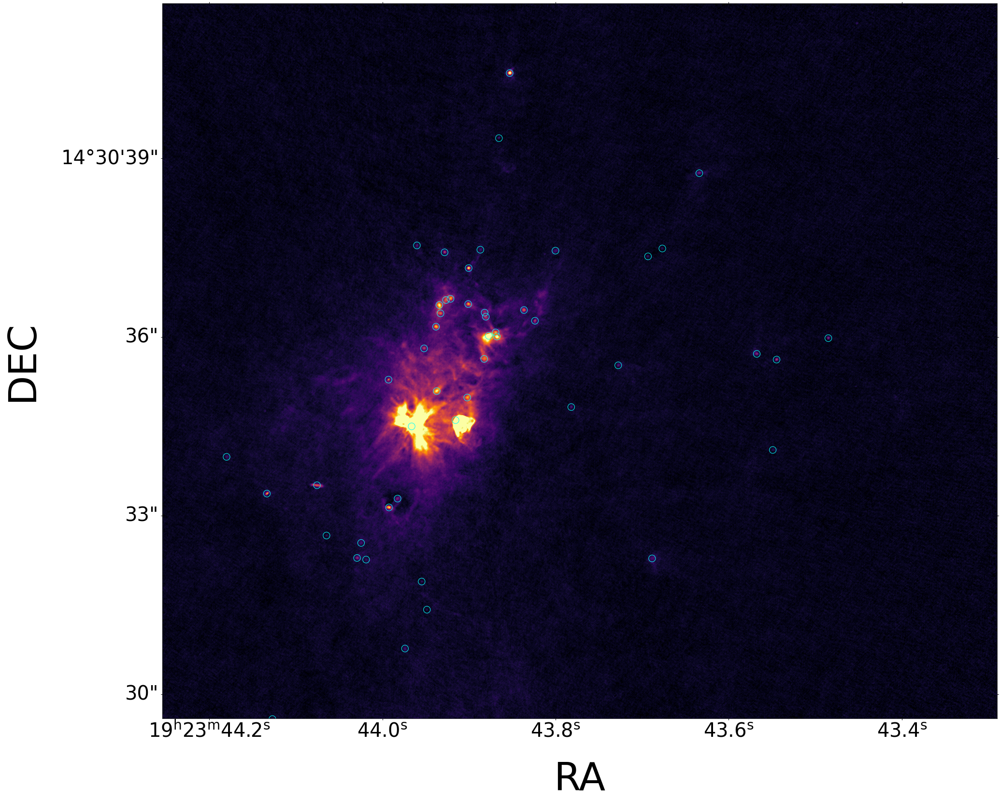

In [6]:
def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40,xoffset=0.05):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+(0.4+xoffset)*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')

hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['b6_xsky'],catalog['b6_ysky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=False,color='w',xysource=xysource)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan')
ax1.imshow(image[0][0], origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.000103489713773963128,vmax=0.0022162524723021867)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4,label=[1,6,2,41,5,7,68,25])
plot_dendrogram_new(ax1, catalog, wcsNB = wcsNB,size=200)

lim1 = wcsNB.world_to_pixel(SkyCoord(290.93426384, 14.50523611, unit='deg'))
lim2 = wcsNB.world_to_pixel(SkyCoord(290.93084938, 14.51165277, unit='deg'))
ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
ax1.set_xlim(6000,9500)
ax1.set_ylim(6000,9000)
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
plt.savefig('w51e_almaimf_highres_new0.png')
xy1 = [6000, 9500]
xy2 = [6000, 9000]
xylim = np.vstack((xy1,xy2)).T
xyskylim = wcsNB.wcs_pix2world(xylim,0)

print(xyskylim)

[[290.93439297  14.50822222]
 [290.93037595  14.51155554]]


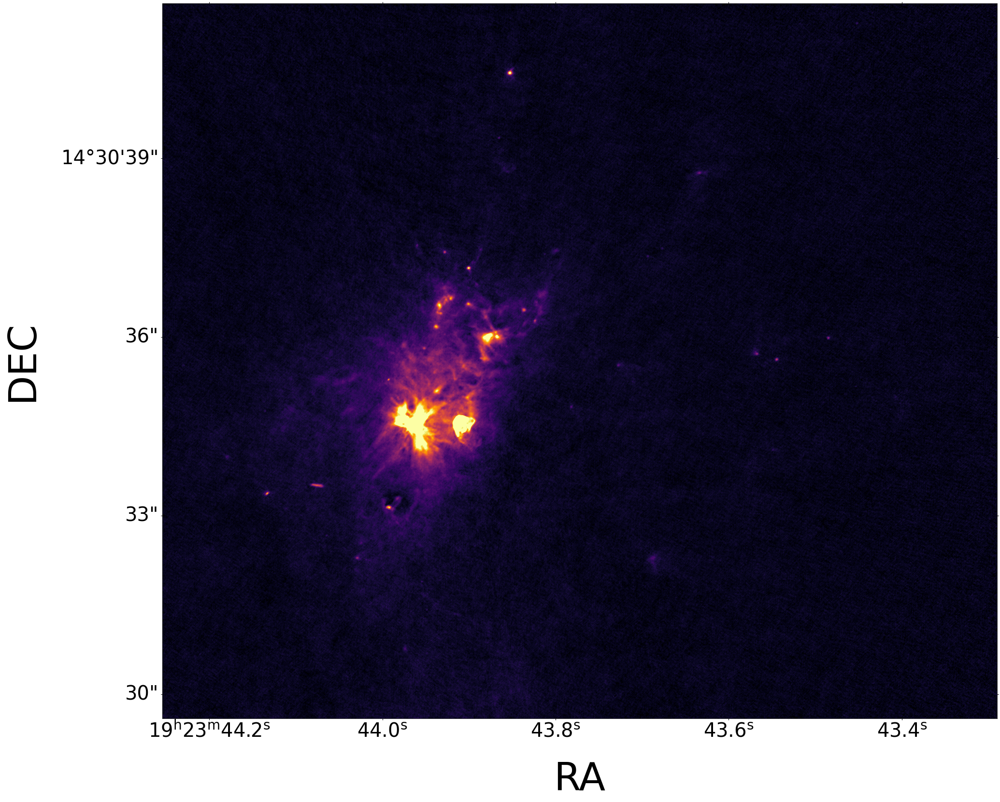

In [7]:
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')

hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['b6_xsky'],catalog['b6_ysky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=False,color='w',xysource=xysource)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan')
ax1.imshow(image[0][0], origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.000103489713773963128,vmax=0.0022162524723021867)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4,label=[1,6,2,41,5,7,68,25])
#plot_dendrogram_new(ax1, catalog, wcsNB = wcsNB,size=200)

lim1 = wcsNB.world_to_pixel(SkyCoord(290.93426384, 14.50523611, unit='deg'))
lim2 = wcsNB.world_to_pixel(SkyCoord(290.93084938, 14.51165277, unit='deg'))
ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
ax1.set_xlim(6000,9500)
ax1.set_ylim(6000,9000)
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
plt.savefig('w51e_almaimf_highres_new4.png')
xy1 = [6000, 9500]
xy2 = [6000, 9000]
xylim = np.vstack((xy1,xy2)).T
xyskylim = wcsNB.wcs_pix2world(xylim,0)
print(xyskylim)

(array(942.01420786), array(971.98640417)) (array(1175.34640893), array(1171.98733723))


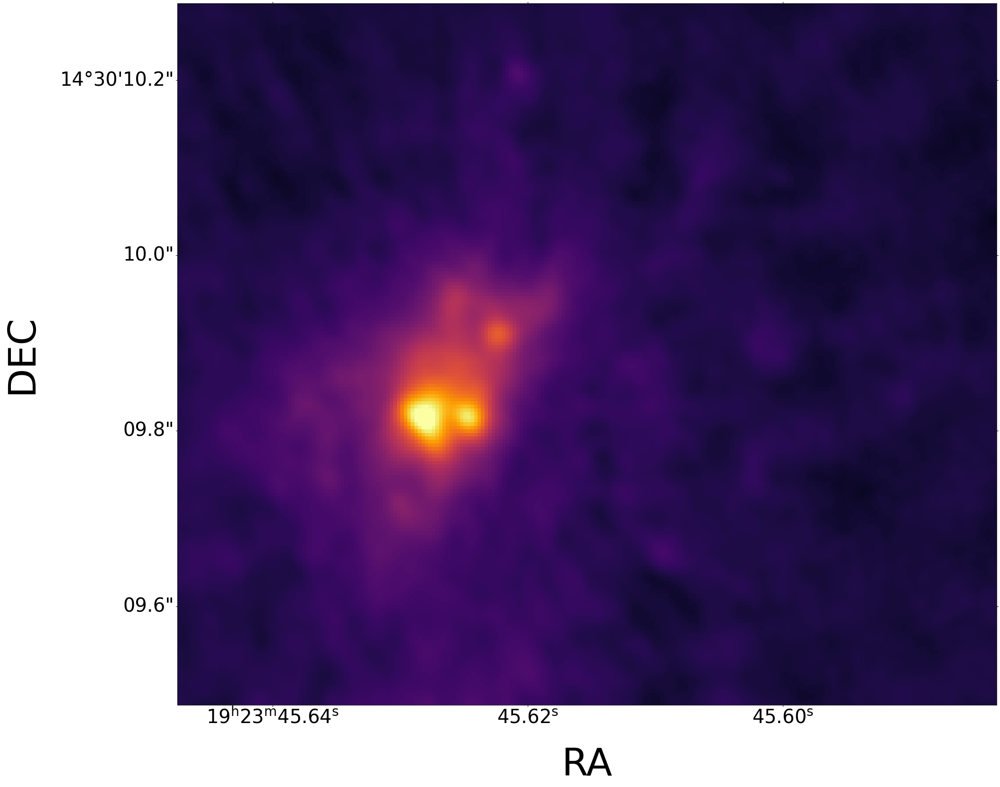

In [8]:
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')
fitsdata = fits.open(w51e_b6_almaimf)
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
image_almaimf = fitsdata[0].data[0][0]
ax1.imshow(image_almaimf, origin='lower',cmap=plt.get_cmap('inferno'),norm = colors.PowerNorm(gamma=0.5, vmin=-0.0035380786497514836,vmax=0.34802060606007097))
lim1 = wcsNBalmaimf.world_to_pixel(SkyCoord(290.93439297, 14.50822222, unit='deg'))
lim2 = wcsNBalmaimf.world_to_pixel(SkyCoord(290.93037595, 14.51155554, unit='deg'))
print(lim1, lim2)
ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
plt.savefig('w51e_almaimf_new0.png')


(array(942.01420786), array(971.98640417)) (array(1175.34640893), array(1171.98733723))
rec_ind [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 27 28 29 30 32]
num 41 29


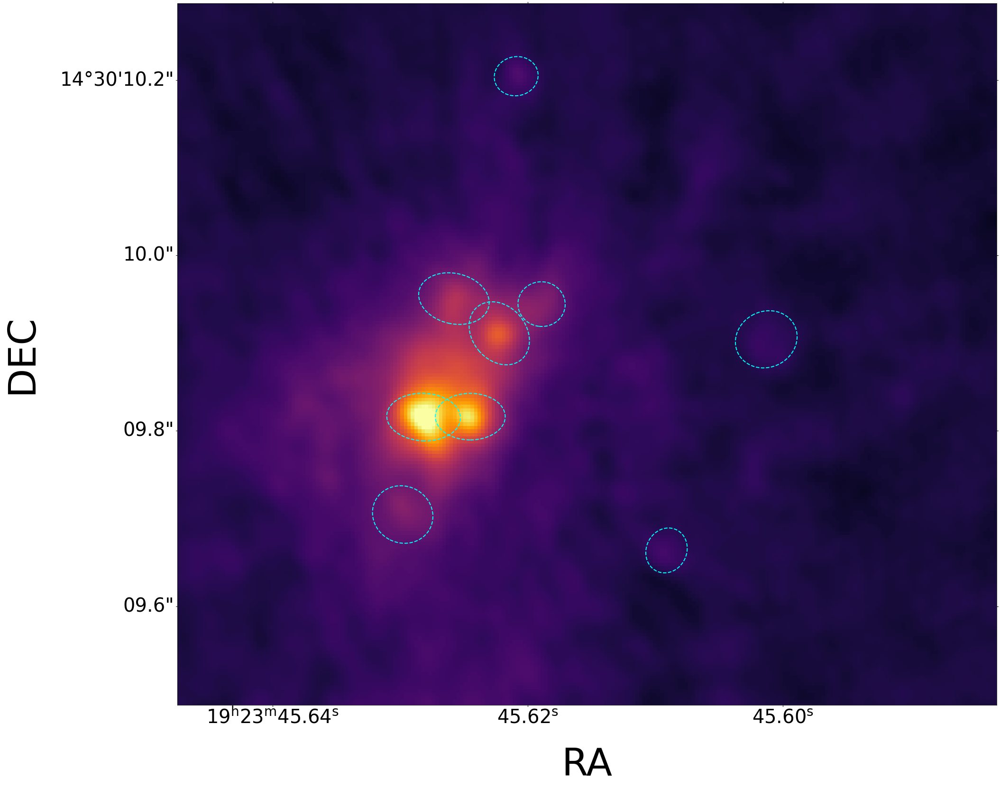

In [9]:
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')
hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  

wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
#ax1.imshow(image, origin='lower',cmap=plt.get_cmap('inferno'),norm = colors.PowerNorm(gamma=0.5, vmin=-0.0035380786497514836,vmax=0.34802060606007097))
lim1 = wcsNBalmaimf.world_to_pixel(SkyCoord(290.93439297, 14.50822222, unit='deg'))
lim2 = wcsNBalmaimf.world_to_pixel(SkyCoord(290.93037595, 14.51155554, unit='deg'))
print(lim1, lim2)
plot_catalog_on_image(ax1,image_almaimf,hdrNBalmaimf,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan',ispower=True, vmin=-0.0035380786497514836,vmax=0.34802060606007097)

ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
plt.savefig('w51e_almaimf_new1.png')


21.639999999997837 AU
95.31645390347364
10313.24031235482 AU
[[290.93381912  14.50877778]
 [290.93232709  14.51066667]]


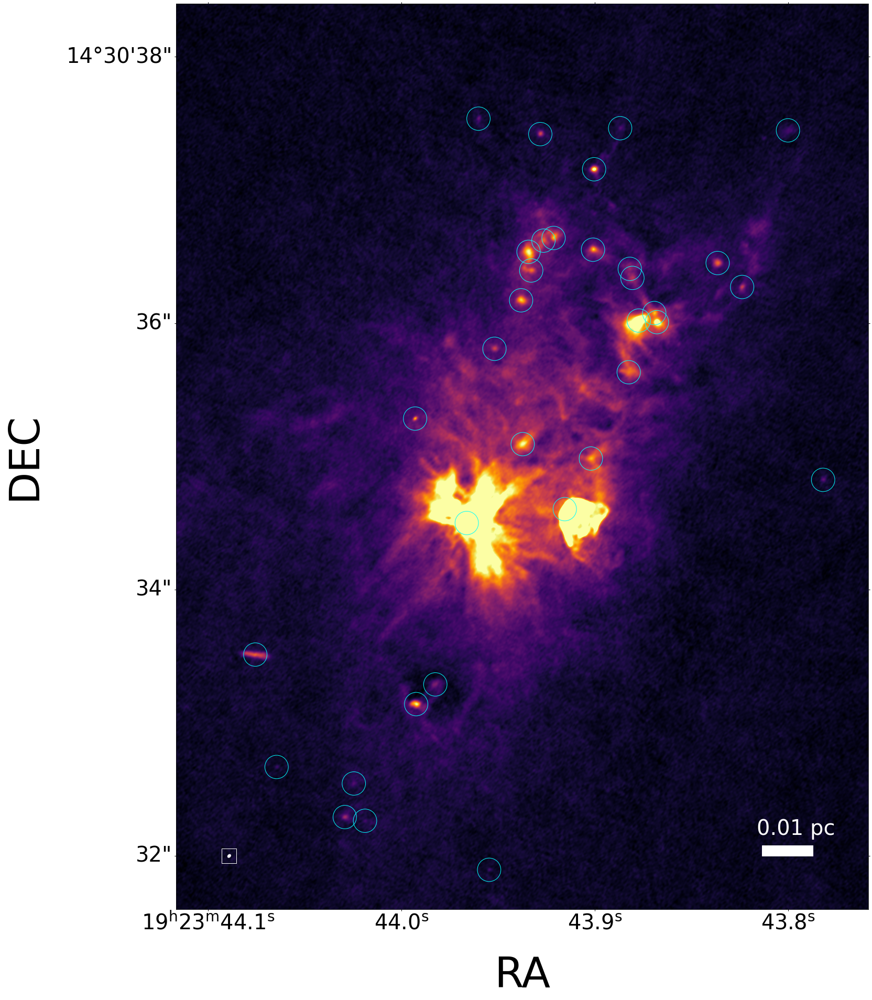

In [10]:
import astropy.units as u
def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40,xoffset=0.05):
    phy_pix_scale = (pixel_scale * dist).to(u.kpc*u.rad)/u.rad
    print(phy_pix_scale.to(u.au))
    scaled_scale = (scale/phy_pix_scale).to(u.rad/u.rad)
    print(scaled_scale)
    ax.add_patch(Rectangle((xpos,ypos),scaled_scale,height,color=color))
    ax.text(xpos+(0.4+xoffset)*scaled_scale, ypos+pad, '%2.2f %s'%(scale.value, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w',square=False,square_size=800):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))
    if square:
        ax.scatter(xpos,ypos,facecolor='none', edgecolor=color,s=square_size,marker='s')
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')
beam_hr = Beam.from_fits_header(hdrNB)    

hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['b6_xsky'],catalog['b6_ysky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=False,color='w',xysource=xysource)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan')
ax1.imshow(image[0][0], origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.000103489713773963128,vmax=0.0022162524723021867)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4,label=[1,6,2,41,5,7,68,25])
plot_dendrogram_new(ax1, catalog, wcsNB = wcsNB,size=2000)

lim1 = wcsNB.world_to_pixel(SkyCoord(290.93426384, 14.50523611, unit='deg'))
lim2 = wcsNB.world_to_pixel(SkyCoord(290.93084938, 14.51165277, unit='deg'))
ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
ax1.set_xlim(6500,7800)
ax1.set_ylim(6500,8200)
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
scale_almaimf = wcsNBalmaimf.proj_plane_pixel_scales()[0]

add_scale_bar(ax1, 7600, 6600, 0.01*u.pc, scaleNB,5.41*u.kpc, unit='pc', xoffset=-0.5)
add_beam(ax1,6600,6600, beam_hr, scaleNB,square=True)
plt.savefig('w51e_almaimf_highres_new0.png')
xy1 = [6500, 7800]
xy2 = [6500, 8200]
xylim = np.vstack((xy1,xy2)).T
xyskylim = wcsNB.wcs_pix2world(xylim,0)
print((0.05*u.pc).to(u.au))
print(xyskylim)

(array(975.34722328), array(1005.32000086)) (array(1062.01323739), array(1118.65378362))
rec_ind [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 27 28 29 30 32]
num 41 29


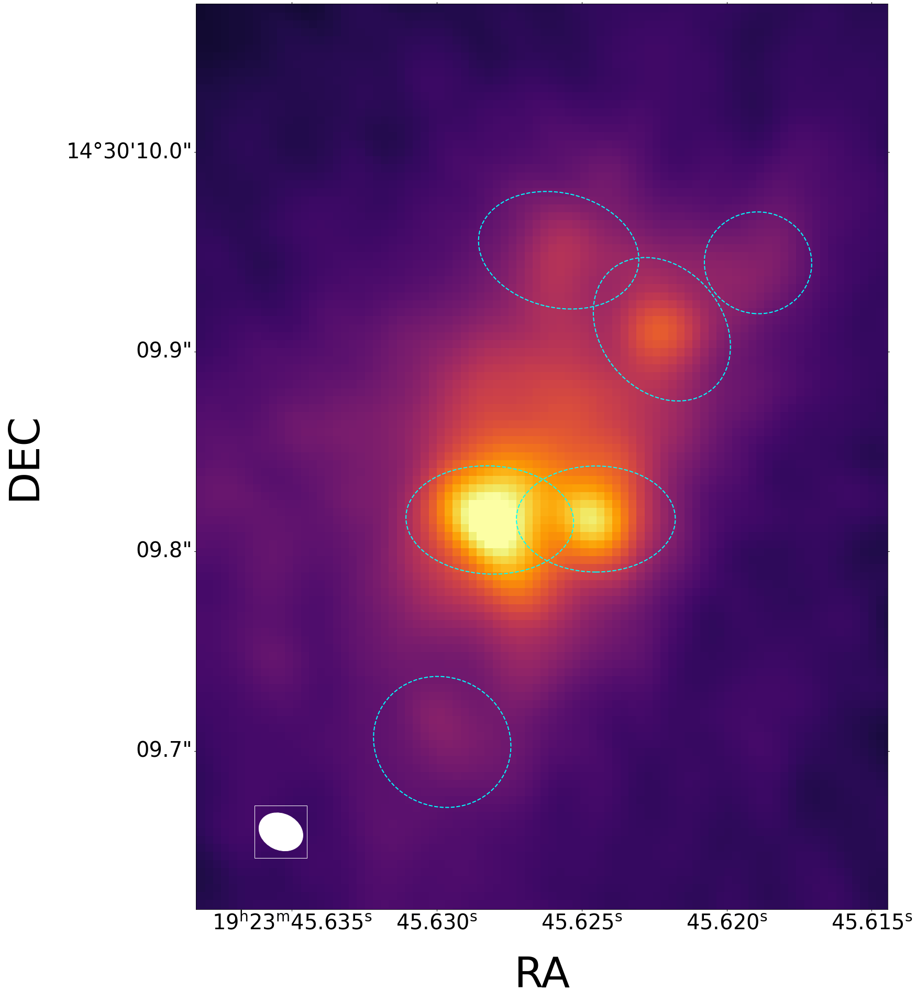

In [11]:
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.18,0.18,0.8,0.8],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')
hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  

wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
#ax1.imshow(image, origin='lower',cmap=plt.get_cmap('inferno'),norm = colors.PowerNorm(gamma=0.5, vmin=-0.0035380786497514836,vmax=0.34802060606007097))
lim1 = wcsNBalmaimf.world_to_pixel(SkyCoord(290.93381912,  14.50877778, unit='deg'))
lim2 = wcsNBalmaimf.world_to_pixel(SkyCoord(290.93232709,  14.51066667, unit='deg'))
print(lim1, lim2)
plot_catalog_on_image(ax1,image_almaimf,hdrNBalmaimf,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan',ispower=True, vmin=-0.0035380786497514836,vmax=0.34802060606007097)
#add_scale_bar(ax1, 1035, 983, 0.01*u.pc, scale_almaimf,5.41*u.kpc, unit='au', xoffset=-0.5)
add_beam(ax1,986,1015, beamalmaimf, scale_almaimf,square=True,square_size=10000)
ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
ax1.set_xticks([])
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
plt.savefig('w51e_almaimf_new1.png')


In [12]:
dfdfdfd

NameError: name 'dfdfdfd' is not defined

In [ ]:
fitsdata = fits.open(w51n_b3_tt0)
image = fitsdata[0].data
hdrNB = fits.getheader(w51n_b3_tt0)  
wcsNB = WCS(hdrNB,naxis=2)

hdrNBalmaimf = fits.getheader(w51n_b3_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=True,beam=beamalmaimf,use_criteria=False,color='w')

plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=True,beam=beamalmaimf,use_criteria=False,label=[1,6,2,41,5,7,68,25],lw=4,xysource=xysource)
catalog = Table.read('../spectral_index/w51n_combined_catalog.fits',format='fits')
plot_dendrogram(ax1, catalog)
ax1.set_xlim(6500, 6500+0.35/scaleNB_phy.value)
ax1.set_ylim(6750, 6750+0.2/scaleNB_phy.value)
skylim1 = wcsNB.pixel_to_world(6500,6750)
skylim2 = wcsNB.pixel_to_world(6500+0.35/scaleNB_phy.value,6700+0.2/scaleNB_phy.value)
print(skylim1,skylim2)
#skycoord1 = coordinates.SkyCoord(skylim1[0].value, skylim1[1].value,
#                            frame=wcs.utils.wcs_to_celestial_frame(wcsNB3).name,unit=(u.deg,u.deg))


#skycoord2 = coordinates.SkyCoord(skylim2[0], skylim2[1],
#                            frame=wcs.utils.wcs_to_celestial_frame(wcsNB3).name,unit=(u.deg,u.deg))


In [ ]:
fitsdata = fits.open(w51n_b6_briggs)
image = fitsdata[0].data
hdrNB = fits.getheader(w51n_b6_briggs)  
wcsNB = WCS(hdrNB,naxis=2)
scaleNB = wcsNB.proj_plane_pixel_scales()[0]
scaleNB_phy = scaleNB * np.pi / 180 * 5.41e3 
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)

hdrNBalmaimf = fits.getheader(w51n_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['x_sky'],catalog['y_sky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=False,color='w')

plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4)
plot_dendrogram(ax1, catalog)
pix1 = wcsNB.world_to_pixel(skylim1)
pix2 = wcsNB.world_to_pixel(skylim2)

ax1.set_xlim(pix1[0],pix2[0])
ax1.set_ylim(pix1[1],pix2[1])




In [ ]:
fitsdata = fits.open(w51n_b6_briggs)
image = fitsdata[0].data
hdrNB = fits.getheader(w51n_b6_briggs)  
wcsNB = WCS(hdrNB,naxis=2)
scaleNB = wcsNB.proj_plane_pixel_scales()[0]
scaleNB_phy = scaleNB * np.pi / 180 * 5.41e3 
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)

hdrNBalmaimf = fits.getheader(w51n_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['x_sky'],catalog['y_sky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=False,color='w')

plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4,label=[1,6,2,41,5,7,68,25])
plot_dendrogram(ax1, catalog)
pix1 = wcsNB.world_to_pixel(skylim1)
pix2 = wcsNB.world_to_pixel(skylim2)

ax1.set_xlim(pix1[0],pix2[0])
ax1.set_ylim(pix1[1],pix2[1])




In [ ]:
catalog = Table.read('../spectral_index/w51n_combined_catalog.fits',format='fits')

fitsdata = fits.open(w51n_b6_briggs)
image = fitsdata[0].data
hdrNB = fits.getheader(w51n_b6_briggs)  
wcsNB = WCS(hdrNB,naxis=2)
scaleNB = wcsNB.proj_plane_pixel_scales()[0]
scaleNB_phy = scaleNB * np.pi / 180 * 5.1e3 
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)

hdrNBalmaimf = fits.getheader(w51n_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['x_sky'],catalog['y_sky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)

plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan',xysource=xysource,lw=4)
plot_dendrogram(ax1, catalog,wcsNB=wcsNB,size=200,color='r')
pix1 = wcsNB.world_to_pixel(skylim1)
pix2 = wcsNB.world_to_pixel(skylim2)
print(pix1,pix2)
ax1.set_xlim(pix1[0],pix2[0])
ax1.set_ylim(pix1[1],pix2[1])




In [ ]:
from regions import Regions
catalog = Table.read('../spectral_index/w51n_combined_catalog.fits',format='fits')

fitsdata = fits.open(w51n_b3_almaimf)
image = fitsdata[0].data
hdrNB = fits.getheader(w51n_b3_almaimf)  
wcsNB = WCS(hdrNB,naxis=2)
scaleNB = wcsNB.proj_plane_pixel_scales()[0]
scaleNB_phy = scaleNB * np.pi / 180 * 5.1e3 
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)

hdrNBalmaimf = fits.getheader(w51n_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['x_sky'],catalog['y_sky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)

plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan',lw=4,vmax=0.02)
plot_dendrogram(ax1, catalog,wcsNB=wcsNB,size=200,color='r')
pix1 = wcsNB.world_to_pixel(skylim1)
pix2 = wcsNB.world_to_pixel(skylim2)
regions = Regions.read('/orange/adamginsburg/w51/TaehwaYoo/Maxime.reg', format='ds9')
#regions.write('/orange/adamginsburg/w51/TaehwaYoo/Maxime.crtf', format='crtf')
regions.write('/orange/adamginsburg/w51/TaehwaYoo/Maxime2.reg', format='ds9')

pixel_region = regions.to_pixel(wcsNB)
pixel_region.plot(ax=ax1, color='red', lw=2.0)



In [ ]:
from astropy.coordinates import SkyCoord
fitsdata = fits.open(w51e_b6_calibrated_pbcor)
image = fitsdata[0].data
hdrNB = fits.getheader(w51e_b6_calibrated_pbcor)  
wcsNB = WCS(hdrNB,naxis=2)
scaleNB = wcsNB.proj_plane_pixel_scales()[0]
scaleNB_phy = scaleNB * np.pi / 180 * 5.41e3 
fig = plt.figure(figsize=(20,20))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)
catalog = Table.read(w51e_dendro_matched_catalog,format='fits')

hdrNBalmaimf = fits.getheader(w51e_b6_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)    
skysource = np.vstack((catalog['b6_xsky'],catalog['b6_ysky'])).T
xysource = wcsNB.wcs_world2pix(skysource,0)
#plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=False,color='w',xysource=xysource)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51e,isb3=False,beam=beamalmaimf,use_criteria=True,color='cyan',xysource=xysource,fontsize=30)

#plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=False,beam=beamalmaimf,use_criteria=True,xysource=xysource,lw=4,label=[1,6,2,41,5,7,68,25])
plot_dendrogram_new(ax1, catalog, wcsNB =wcsNB)

lim1 = wcsNB.world_to_pixel(SkyCoord(290.93426384, 14.50523611, unit='deg'))
lim2 = wcsNB.world_to_pixel(SkyCoord(290.93084938, 14.51165277, unit='deg'))
ax1.set_xlim(lim1[0],lim2[0])
ax1.set_ylim(lim1[1],lim2[1])
#ax1.set_xlim(4500,8000)
#ax1.set_ylim(2500,7800)
plt.savefig('w51e_almaimf_highres.png')


In [ ]:
fitsdata = fits.open(w51n_b3_tt0)
image = fitsdata[0].data
hdrNB = fits.getheader(w51n_b3_tt0)  
wcsNB = WCS(hdrNB,naxis=2)

fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=True,use_criteria=False)
catalog = Table.read('../alpha/w51n_combined_catalog.fits',format='fits')
plot_dendrogram(ax1, catalog)
ax1.set_xlim(6500,8500)
ax1.set_ylim(7000,7500)

In [ ]:
fitsdata = fits.open(w51n_b3_tt0)
image = fitsdata[0].data
hdrNB = fits.getheader(w51n_b3_tt0)  
wcsNB = WCS(hdrNB,naxis=2)

hdrNBalmaimf = fits.getheader(w51n_b3_almaimf)  
wcsNBalmaimf = WCS(hdrNBalmaimf,naxis=2)
beamalmaimf = Beam.from_fits_header(hdrNBalmaimf)
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.1,0.1,0.9,0.9],projection=wcsNB)
plot_catalog_on_image(ax1,image,hdrNB,cat_w51n,isb3=True,beam=beamalmaimf)
catalog = Table.read('../alpha/w51n_combined_catalog.fits',format='fits')
plot_dendrogram(ax1, catalog)
ax1.set_xlim(6500,8500)
ax1.set_ylim(7000,8000)